Roll: 2019121004 <br>
Name: Avani Gupta

In [1]:
import numpy as np 
import cv2
import glob
import os 
import matplotlib.pyplot as plt

## Image Mosaicing

1. Use any feature detector and descriptor (e.g. SIFT) to find matches between two
partially overlapping images. You can use inbuilt functions for this.
2. Estimate the homography matrix between the two images robustly.
3. Transform one of the images to the other’s reference frame using the homography
matrix.
4. Stitch the two images together.
5. Repeat this for multiple images to produce a singly mosaic/panorama.
6. Demonstrate the results on different scenes from the given data.
7. Additionally, capture a set of overlapping images of a scene with your camera and
report the results on the same.
8. BONUS: Think of an algorithm which can stitch images given in any order without
human intervention. Modify your existing code accordingly.

In [2]:
def display_img_arr(img_arr, r, c, dim,titles_arr):
    fl = 0
    fig = plt.figure(figsize = dim)
    for i in range(r):
        for j in range(c):
            if len(img_arr) == fl:
                break
            ax1 = fig.add_subplot(r, c, fl + 1)
            ax1.set_title(titles_arr[fl], fontsize = 20)
            ax1.imshow(img_arr[fl], cmap = 'gray')
            fl = fl + 1
    plt.show()

In [3]:
def calHomography(img1_pt_list, img2_pt_list):

    matx = []
    for i in range(len(img1_pt_list)):
        
        matx.append([*img2_pt_list[i],0,0,0,*(-1*(img2_pt_list[i])*(img1_pt_list[i][0]))])
        matx.append([0, 0, 0, *img2_pt_list[i], *(-1*(img2_pt_list[i]*img1_pt_list[i][1]))])
        
    matx = np.array(matx)  
    u,s,vh = np.linalg.svd(matx) 
    Hmatx = vh.T[:,8].reshape(3,3)
    return Hmatx/Hmatx[2][2]



def calcHomoRansac(homo_img1_pt_list, homo_img2_pt_list, matches, distance, threshold):

    maxInliers = []
    inliers = []
    
    finalH = None
    for i in range(100):
        r4 = np.random.randint(0,len(homo_img2_pt_list),5) 
        img1_pt_list = []
        img2_pt_list = []
        
        for j in r4:
            img1_pt_list.append(homo_img1_pt_list[j])
            img2_pt_list.append(homo_img2_pt_list[j])
            
        Hmatx = calHomography(img1_pt_list, img2_pt_list)
        
        for i in range(len(homo_img1_pt_list)):
            proj = Hmatx@homo_img2_pt_list[i]
            currDist = np.linalg.norm(proj/proj[2] - homo_img1_pt_list[i])
            if currDist < distance:
                inlier = homo_img2_pt_list[i]
                inliers.append(inlier)
                
        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = Hmatx
            
        if len(maxInliers) > len(homo_img1_pt_list)*threshold:
            break
            
    return finalH

def convert_ToHomo(x,X):
    ones = np.ones((len(x),1))
    x = np.concatenate(
        (x,ones),
        axis = 1)
    X = np.concatenate(
        (X,ones),
        axis = 1)
    return x, X

def crop(frame):
  #crop top
    if not np.sum(frame[0]):
        return crop(frame[1:])
  #crop bottom
    if not np.sum(frame[-1]):
        return crop(frame[:-2])
  #crop left
    if not np.sum(frame[:,0]):
        return crop(frame[:,1:])
  #crop right
    if not np.sum(frame[:,-1]):
        return crop(frame[:,:-2])
    return frame


## Two Images

In [4]:
def stichTwoImages(img1,img2):
    matches, kp1 , kp2 , des1 , des2 = match_keypoints(img1,img2) #matches has best matches
    kp1_point_list = []
    kp2_point_list = []
    for m in matches:
        kp1_point_list.append(kp1[m[0].queryIdx].pt)
        kp2_point_list.append(kp2[m[0].trainIdx].pt)
        
    
    homo_kp1_point_list, homo_kp2_point_list  = convert_ToHomo(kp1_point_list, kp2_point_list )
    H = calcHomoRansac(homo_kp1_point_list, homo_kp2_point_list, matches, 4, 0.2)
    
    total_img_shape = img1.shape[1] + img2.shape[1]
    dst = cv2.warpPerspective(img2,H,(total_img_shape, img1.shape[0]))
    
    dst[0:img1.shape[0], 0:img1.shape[1]] = img1 
    
    stiched = crop(dst)
    display_img_arr([dst,img1,img2,stiched], 1, 3, (20, 20), ['dst','img1','img2'])
    display_img_arr([stiched], 1, 3, (20, 20), ['trimmed_merged'])
    return stiched

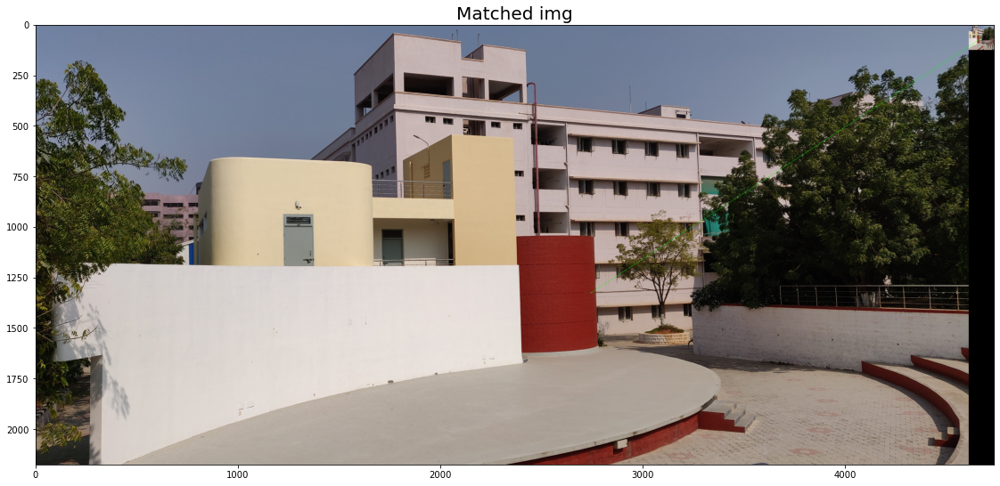

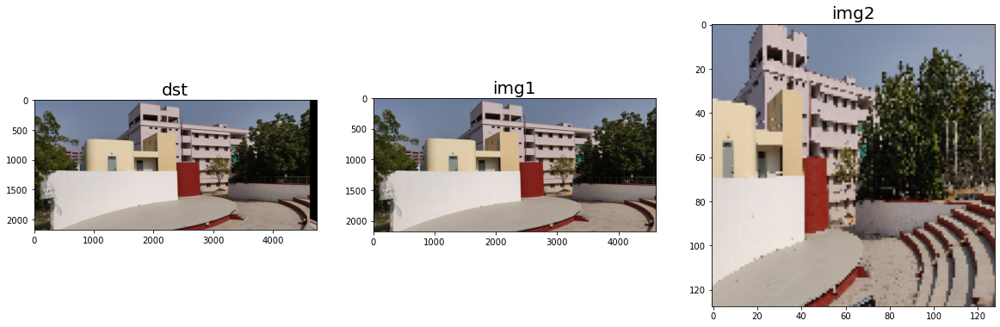

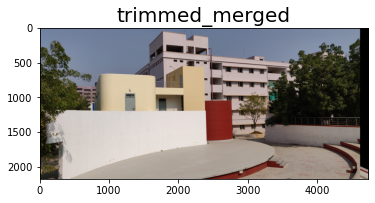

In [5]:
def match_keypoints(img1,img2):
    sift = cv2.SIFT_create()
    
    Minimum_Match_count = 1
    
    kp1, des1 = sift.detectAndCompute(img1, None) 
    kp2, des2 = sift.detectAndCompute(img2, None)

    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1,des2, k=2)  
    good_matches = [] 
    for m,n in matches:
        if m.distance < 0.5*n.distance:
            good_matches.append([m])  

    matchedImg = cv2.drawMatchesKnn(img1,kp1,img2,kp2,good_matches,None,flags=2, matchColor = (0,255,0))
    display_img_arr([matchedImg], 2, 1, (20, 20), ["Matched img"])
    
    if ( len(good_matches) >= Minimum_Match_count) :
        return good_matches, kp1 , kp2 , des1 , des2
    
    else :
        print('\n Not sufficient matches found')
        return good_matches, kp1 , kp2 , des1 , des2
        
  

images = [plt.imread(file) for file in glob.glob('../images/Image Mosaicing/'+str(1)+'*.jpg')]

Minimum_Match_count = 15 # set minimum required matches
stiched = stichTwoImages(images[1],cv2.resize(images[2],(128,128)))

## Multiple Images

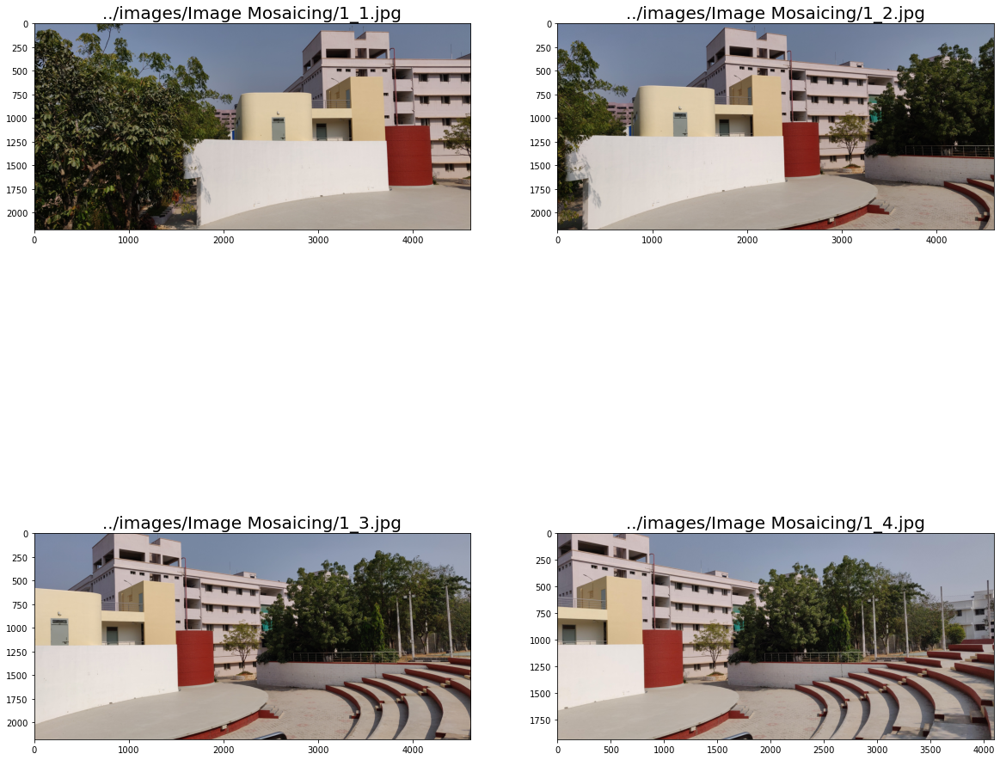

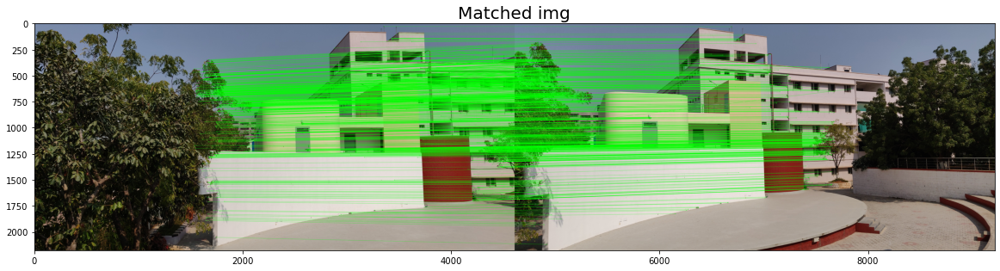

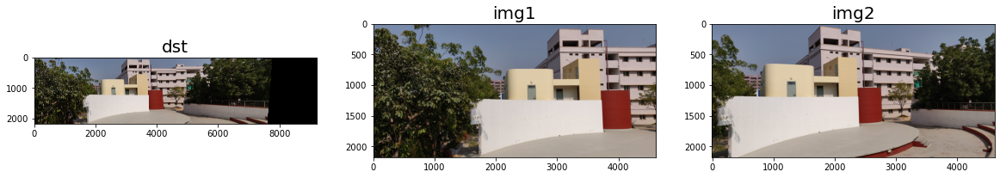

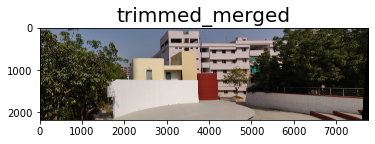

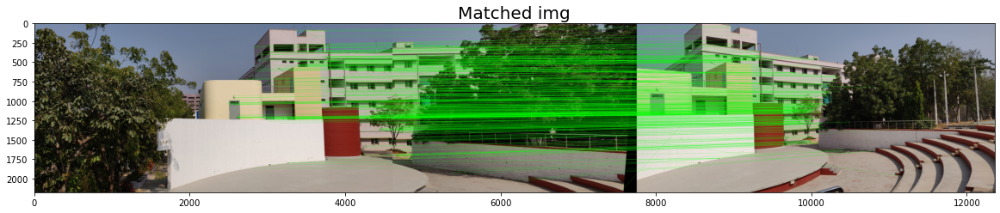

...

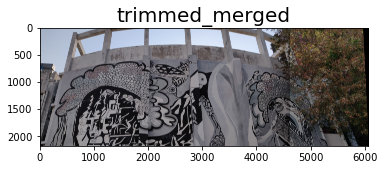

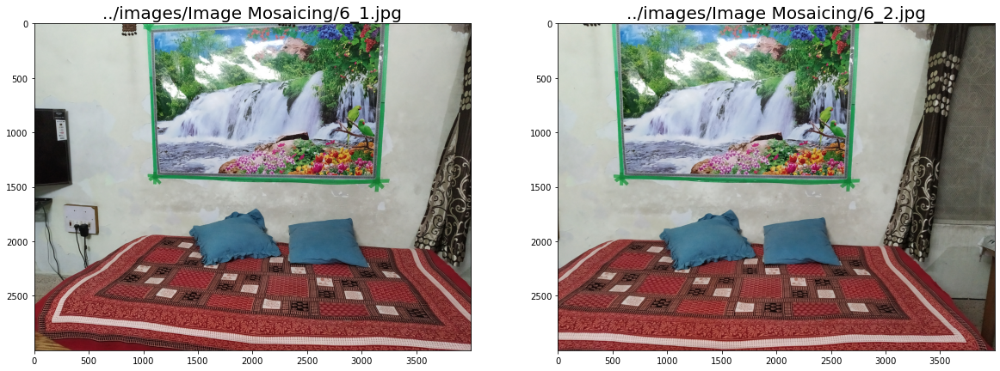

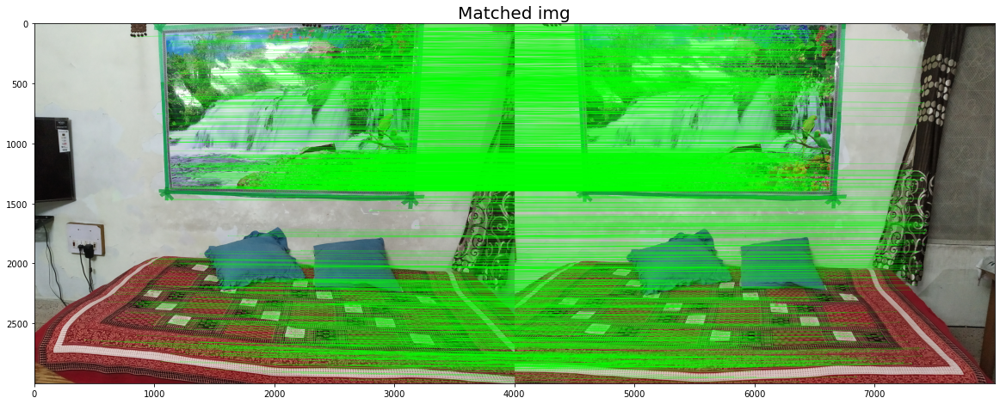

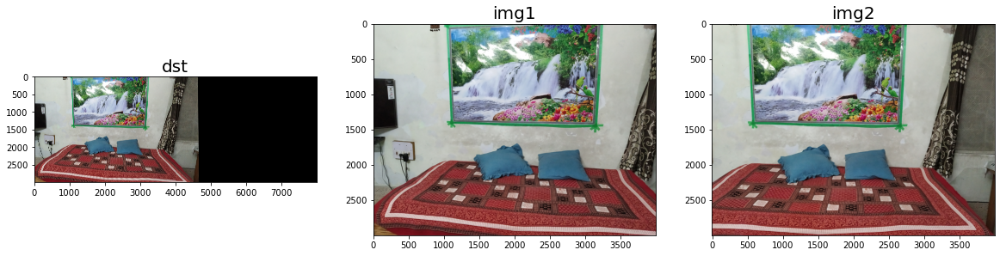

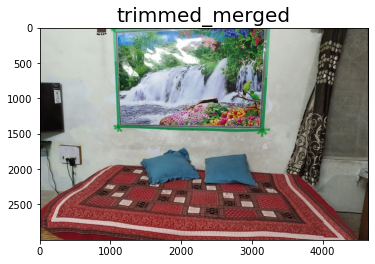

In [6]:
def stichMultiImages(num_images):
    for i in range(1,num_images+1):
        filenames = glob.glob('../images/Image Mosaicing/'+str(i)+'*.jpg')
        if(len(filenames)==0):
            filenames = glob.glob('../images/Image Mosaicing/'+str(i)+'*.png')
            
        filenames = sorted(filenames)
        images = []
        for file in filenames:
            im = cv2.cvtColor(cv2.imread(file),cv2.COLOR_BGR2RGB)
#             images.append(cv2.resize(im,(im.shape[0]//10,im.shape[1]//10)))
            images.append(im)
            
        display_img_arr(images, 2, 2, (20, 20), filenames)
        stiched = stichTwoImages(images[0],images[1])
        k = 2 
        while(k<len(images)):
            sitched = stichTwoImages(stiched,images[k])
            k = k+1
                        
stichMultiImages(6)            
        

# Bonus

Think of an algorithm which can stitch images given in any order without
human intervention. Modify your existing code accordingly.

Match each image with the other image and take list of matches for each image with the other image. <br>

Now, based on number of matches determine order to stich the image

